In [1]:
import numpy as np
import matplotlib.pyplot as plt
import plotly.graph_objects as go

### Definition of Lorenz System
x' = σ(y−x) <br>
y' = ρx−y−xz <br>
z' = −βz+xy <br>

In [2]:
# define constants
rho = 28  # scaled Rayleigh number
sigma = 10  # Prandtl number
beta = 8 / 3  # geometry aspect ratio


# define lorenz system
def lorenz(x, y, z):
    dx = sigma * (y - x)
    dy = rho * x - y - x * z
    dz = x * y - beta * z
    return np.array([dx, dy, dz])

### Numerical Methods to Solve Lorenz System

### 1. Euler's Method
y<sub>n+1</sub> = y<sub>n</sub> + h*f(x<sub>n</sub>,y<sub>n</sub>)  ,    n= 0,1,...

In [3]:
def eulers_method(initial_values, num_time_pts, h):
    """Solves first order non-linear differential equation systems with Euler's method.
    Args:
        initial_values: initial x,y,z values
        num_time_pts: number of time points to plot
        h: next_value - current_value
    Returns:
        2-D array: trajectory of lorenz attractor
    """
    # trajectory = [[x0,x1,x2,...], [y1,y2,y3],...], [z1,z2,z3,...]]
    trajectory = np.zeros((3, num_time_pts))  # trajectory matrix
    # x, y, z = initial_values[0], initial_values[1], initial_values[2]
    x, y, z = initial_values
    for i in range(0, num_time_pts):
        trajectory[0, i] = x
        trajectory[1, i] = y
        trajectory[2, i] = z

        x_next = x + h * lorenz(x, y, z)[0]
        y_next = y + h * lorenz(x, y, z)[1]
        z_next = z + h * lorenz(x, y, z)[2]
        x, y, z = x_next, y_next, z_next
    return trajectory

### 2. Heun's Method (Modified Euler Method)
y<sub>n+1</sub> = y<sub>n</sub> + (h/2) (f(x<sub>n</sub>, y<sub>n</sub>) + f(x<sub>n</sub> + h, y<sub>n</sub> +  h f(x<sub>n</sub>, y<sub>n</sub>)))


In [4]:
def heuns_method(initial_values, num_time_pts, h):
    """Solves first order non-linear differential equation systems with Heun's method.
    Args:
        initial_values: initial x,y,z values
        num_time_pts: number of time points to plot
        h: next_value - current_value
    Returns:
        2-D array: trajectory of lorenz attractor
    """
    x, y, z = initial_values
    trajectory = np.zeros((3, num_time_pts))
    for i in range(0, num_time_pts):
        trajectory[0, i] = x
        trajectory[1, i] = y
        trajectory[2, i] = z

        # calculate mid points
        x_mid = x + h * lorenz(x, y, z)[0]
        y_mid = y + h * lorenz(x, y, z)[1]
        z_mid = z + h * lorenz(x, y, z)[2]

        # calculate slopes at initial points
        s_0x = lorenz(x, y, z)[0]
        s_0y = lorenz(x, y, z)[1]
        s_0z = lorenz(x, y, z)[2]

        # calculate slopes at midpoints
        s_mx = lorenz(x_mid, y_mid, z_mid)[0]
        s_my = lorenz(x_mid, y_mid, z_mid)[1]
        s_mz = lorenz(x_mid, y_mid, z_mid)[2]

        # update x,y,z points
        x_next = x + (h / 2) * (s_0x + s_mx)
        y_next = y + (h / 2) * (s_0y + s_my)
        z_next = z + (h / 2) * (s_0z + s_mz)

        x, y, z = x_next, y_next, z_next

    return trajectory

### 3. Runge-Kutta Method of Order Four

In [5]:
def rk4_method(initial_state, num_time_pts, h):
    x, y, z = initial_state
    trajectory = np.zeros((3, num_time_pts))
    for i in range(num_time_pts):
        # fill trajectory matrix
        trajectory[0, i] = x
        trajectory[1, i] = y
        trajectory[2, i] = z
        # define ODEs
        k_1x = h * lorenz(x, y, z)[0]
        k_1y = h * lorenz(x, y, z)[1]
        k_1z = h * lorenz(x, y, z)[2]
        # compute first set of intermediate values
        k_2x = h * lorenz(x + k_1x / 2, y + k_1y / 2, z + k_1z / 2)[0]
        k_2y = h * lorenz(x + k_1x / 2, y + k_1y / 2, z + k_1z / 2)[1]
        k_2z = h * lorenz(x + k_1x / 2, y + k_1y / 2, z + k_1z / 2)[2]
        # compute second set of intermediate values
        k_3x = h * lorenz(x + k_2x / 2, y + k_2y / 2, z + k_2z / 2)[0]
        k_3y = h * lorenz(x + k_2x / 2, y + k_2y / 2, z + k_2z / 2)[1]
        k_3z = h * lorenz(x + k_2x / 2, y + k_2y / 2, z + k_2z / 2)[2]
        # compute third set of intermediate values
        k_4x = h * lorenz(x + k_3x, y + k_3y, z + k_3z)[0]
        k_4y = h * lorenz(x + k_3x, y + k_3y, z + k_3z)[1]
        k_4z = h * lorenz(x + k_3x, y + k_3y, z + k_3z)[2]
        # update variables
        x_next = x + (1 / 6) * (k_1x + (2 * k_2x) + (2 * k_3x) + k_4x)
        y_next = y + (1 / 6) * (k_1y + (2 * k_2y) + (2 * k_3y) + k_4y)
        z_next = z + (1 / 6) * (k_1z + (2 * k_2z) + (2 * k_3z) + k_4z)

        x, y, z = x_next, y_next, z_next

    return trajectory

In [6]:
def put_markers(time_pt, trajectory):
    markers = np.zeros((3, 1))
    x = trajectory[0, time_pt]
    y = trajectory[1, time_pt]
    z = trajectory[2, time_pt]
    markers[0] = x
    markers[1] = y
    markers[2] = z
    return markers


def simulation_single(trajectory, method_name, time_pt):
    name = method_name.capitalize()
    # plot trajectory
    trace = go.Scatter3d(
        x=trajectory[0, :],
        y=trajectory[1, :],
        z=trajectory[2, :],
        mode="lines",
        line=dict(color='deepskyblue', width=2),
        marker=dict(size=2),
        name=f"{name}"
    )
    marker = go.Scatter3d(
        x=put_markers(time_pt, trajectory)[0, :],
        y=put_markers(time_pt, trajectory)[1, :],
        z=put_markers(time_pt, trajectory)[2, :],
        mode="markers",
        marker_color='darkblue',
        marker_size=5,
        name=f"{name} marker"
    )
    df = [trace, marker]
    fig = go.Figure(data=df)
    fig.update_layout(
        scene=dict(
            aspectmode="cube",
            xaxis=dict(title="X"),
            yaxis=dict(title="Y"),
            zaxis=dict(title="Z"),
        ),
        title=f"Lorenz Attractor, Marker at t={time_pt}",
        margin=dict(l=0, r=0, b=0, t=40),
    )
    fig.show()



def simulation_multiple(trj_euler, trj_heuns, trj_rk4, time_pt):
    trace_eulers = go.Scatter3d(
        x=trj_euler[0, :],
        y=trj_euler[1, :],
        z=trj_euler[2, :],
        mode="lines",
        line=dict(color='pink', width=2),
        marker=dict(size=2),
        name="Euler"
    )
    trace_heuns = go.Scatter3d(
        x=trj_heuns[0, :],
        y=trj_heuns[1, :],
        z=trj_heuns[2, :],
        mode="lines",
        line=dict(color='deepskyblue', width=2),
        marker=dict(size=2),
        name="Heun"
    )
    trace_rk4 = go.Scatter3d(
        x=trj_rk4[0, :],
        y=trj_rk4[1, :],
        z=trj_rk4[2, :],
        mode="lines",
        line=dict(color='lightgreen', width=2),
        marker=dict(size=2),
        name="Runge-Kutta(4. order)"
    )

    # add markers
    mark_euler = go.Scatter3d(
        x=put_markers(time_pt, trj_euler)[0, :],
        y=put_markers(time_pt, trj_euler)[1, :],
        z=put_markers(time_pt, trj_euler)[2, :],
        mode="markers",
        marker_color='darkgreen',
        marker_size=5,
        name="Euler Marker"
    )
    mark_heuns = go.Scatter3d(
        x=put_markers(time_pt, trj_heuns)[0, :],
        y=put_markers(time_pt, trj_heuns)[1, :],
        z=put_markers(time_pt, trj_heuns)[2, :],
        mode="markers",
        marker_color='deeppink',
        marker_size=5,
        name="Heun Marker"
    )
    mark_rk4 = go.Scatter3d(
        x=put_markers(time_pt, trj_rk4)[0, :],
        y=put_markers(time_pt, trj_rk4)[1, :],
        z=put_markers(time_pt, trj_rk4)[2, :],
        mode="markers",
        marker_color='blueviolet',
        marker_size=5,
        name="RK4 Marker"
    )

    data = [trace_eulers, trace_heuns, trace_rk4,
            mark_euler, mark_heuns, mark_rk4]

    fig = go.Figure(data=data)
    fig.update_layout(
        scene=dict(
            aspectmode="cube",
            xaxis=dict(title="X"),
            yaxis=dict(title="Y"),
            zaxis=dict(title="Z"),
        ),
        title=f"Lorenz Attractor, Markers at t={time_pt}",
        margin=dict(l=0, r=0, b=0, t=40),
    )
    fig.show()
    

In [7]:
initial_state = [0, 1, 20]
trajectory_eulers = eulers_method(initial_state, 25000, 0.001)
trajectory_heuns = heuns_method(initial_state, 25000, 0.001)
trajectory_rk4 = rk4_method(initial_state, 25000, 0.001)
time_pt1 = 1000
sim = simulation_multiple(
    trajectory_eulers, trajectory_heuns, trajectory_rk4, time_pt1)
time_pt2 = 12000
sim = simulation_multiple(
    trajectory_eulers, trajectory_heuns, trajectory_rk4, time_pt2)
time_pt3 = 24000
sim = simulation_multiple(
    trajectory_eulers, trajectory_heuns, trajectory_rk4, time_pt3)

Different inital states with the same step size can result in big differences in long periods of time. I observe this effect by giving 2 different initial states: x1=1, y1=1, z1=1 and x2=1.5, y1=1.5, z2=1.5.

In [8]:
i_state_1 = [1, 1, 1]
i_state_2 = [1.5, 1.5, 1.5]
trj1 = rk4_method(i_state_1, 25000, 0.001)
trj2 = rk4_method(i_state_2, 25000, 0.001)
sim = simulation_single(trj1,"runge-kutta",20000)
sim = simulation_single(trj2,"runge-kutta",20000)

### Poincaré Map


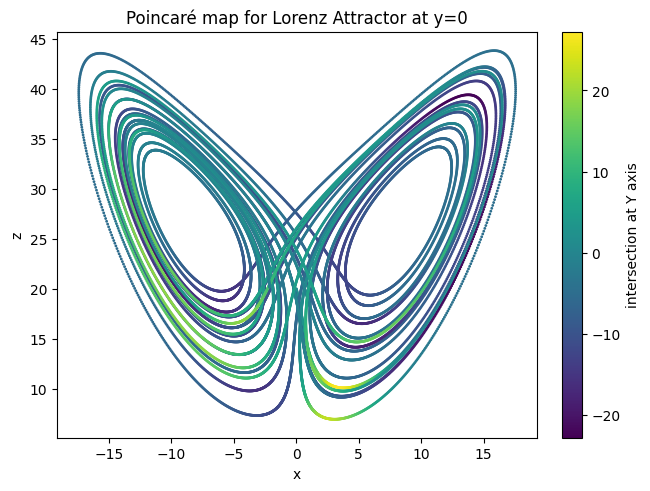

In [9]:
def get_intersections(trj):
    return trj[1]


x, z = trajectory_rk4[0], trajectory_rk4[2]
fig, ax = plt.subplots(layout='constrained')
sc = ax.scatter(x, z, c=get_intersections(trj1), cmap="viridis", s=1)
ax.set_xlabel("x")
ax.set_ylabel("z")
fig.colorbar(mappable=sc, ax=ax, label='intersection at Y axis')
ax.set_title("Poincaré map for Lorenz Attractor at y=0")
plt.show()

In [10]:
### RUN IF NECESSARY ###
# %pip install numpy
# %pip install plotly
# %pip install nbformat # Mime type rendering requires nbformat>=4.2.0
# %pip install scipy
# %pip install matplotlib

Resources
1. https://plotly.com/python/3d-line-plots/
2. https://matplotlib.org/stable/api/_as_gen/matplotlib.axes.Axes.scatter.html#matplotlib.axes.Axes.scatter </br>
For the numerical methods: </br>
3. Goode, S. W., & Annin, S. A. (2014). Differential Equations and Linear Algebra (Pearson New International Edition, Third Edition). Pearson Higher Ed. </br>
For the lorenz system:
4. Hateley, J.C. (2016). THE LORENZ SYSTEM 1 FORMULATION 1 Formulation. <br>
5. Wang, X., & Wang, M. (2008). A hyperchaos generated from Lorenz system. Physica A: Statistical Mechanics and Its Applications, 387(14), 3751–3758. https://doi.org/10.1016/j.physa.2008.02.020</br>
For the simulation:
6. https://plotly.com/python/reference/scatter/#scatter</br>
7. https://community.plotly.com/t/how-to-plot-3d-interactive-stem-plot-in-plotly/75918/3 </br>
For chaos and poincaré map:
8. https://www.esa.int/gsp/ACT/projects/poincare_chaos_classification/
9. https://matplotlib.org/stable/gallery/images_contours_and_fields/contour_demo.html#sphx-glr-gallery-images-contours-and-fields-contour-demo-py
